In [1]:
from IPython.display import HTML

HTML('''<script>
code_show=true;
function code_toggle() {
 if (code_show){
 $('div.input').hide();
 } else {
 $('div.input').show();
 }
 code_show = !code_show
}
$( document ).ready(code_toggle);
</script>
<form action="javascript:code_toggle()">
<input type="submit" value="Click here to toggle on/off the raw code.">
</form>''')

In [28]:
from IPython.display import Image
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.gridspec as grd
import folium as fol
from sklearn import decomposition, preprocessing
from scipy import stats
from scipy.stats import shapiro, normaltest, anderson, mannwhitneyu
from branca.element import Figure
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.io as pio
%matplotlib inline

In [3]:
# Importing Listings And Reviews Data from JOJIE
def load_data(date):
    """Return AirBnb data sets as pandas.DataFrame.

    Accesses /mnt/data/public/insideairbnb/data.insideairbnb.com/japan/
    kantō/tokyo/ and loads listings and review data sets into
    pandas.Dataframe.

    Parameters
    ----------
    date : str
        Scraping date in yyy-mm-dd format

    Returns
    -------
    """

    listings_raw = pd.read_csv('/mnt/data/public/insideairbnb/'
                               'data.insideairbnb.com/japan/kantō/tokyo/'
                               f'{date}/data/listings.csv.gz',
                               compression='gzip',
                               low_memory=False,
                               parse_dates=['last_scraped', 'host_since'])

    return listings_raw

In [4]:
# Load Data from JOJIE
# lr = load_data('2021-07-20')

In [5]:
# Feature Selection, Data Cleaning, and Dummy Variable Creation
# fields = ['name',
#           'host_id',
#           'host_name',
#           'last_scraped',
#           'host_since',
#           'host_response_rate',
#           'host_is_superhost',
#           'host_listings_count',
#           'latitude',
#           'longitude',
#           'property_type',
#           'room_type',
#           'accommodates',
#           'bathrooms_text',
#           'bedrooms',
#           'beds',
#           'amenities',
#           'price',
#           'minimum_nights',
#           'maximum_nights',
#           'availability_365',
#           'number_of_reviews',
#           'review_scores_rating',
#           'review_scores_accuracy',
#           'review_scores_cleanliness',
#           'review_scores_checkin',
#           'review_scores_communication',
#           'review_scores_location',
#           'review_scores_value',
#           'reviews_per_month']

# Select fields and drop rows with missing values
# lr_select = lr[fields].dropna()

# Count the number of listed amenities
# lr_select['amenities_ct'] = lr_select['amenities'].str.strip('[]').\
# str.split(',').str.len()

# Calculate number of days as host
# lr_select['days_as_host'] = (lr_select.last_scraped -
#                              lr_select.host_since).dt.days

# Convert price to float
# lr_select['price'] = lr_select['price'].replace({'\$': '',
#                                                  ',': ''},
#                                                 regex=True).astype(float)

# Extract bathroom count from bathrooms_text
# def bathrooms(text):
#     """Extract number of bathrooms."""
#     try:
#         bath = float(text.split()[0])
#     except:
#         if 'half' in text.lower():
#             bath = 0.5
#         else:
#             bath = np.nan
#     return bath

# lr_select['bathrooms'] = lr_select['bathrooms_text'].apply(bathrooms)

# Host response rate to float
# lr_select['hrr'] = lr_select['host_response_rate'].replace({'%': ''},
#                                                            regex=True)
# lr_select['hrr'] = lr_select['hrr'].astype(float) / 100

# One-hot encoding of categorical variables
# Superhost Tagging
# OH_superhost = pd.get_dummies(lr_select.host_is_superhost,
#                             prefix='superhost',
#                             drop_first=True)

# Re-Tag Superhost
# lr_select['host_is_superhost'] = np.where(lr_select.host_is_superhost ==
# 't',
#                                           'Superhost',
#                                           'Non-Superhost')

# Drop columns
# lr_select = lr_select.drop(['amenities',
#                             'last_scraped',
#                             'host_since',
#                             'bathrooms_text',
#                             'host_response_rate'], axis=1)

# Export to csv file
# lr_select.dropna().to_csv('airbnb20210720.csv')
# OH_superhost.to_csv('OH_superhost20210720.csv')

<b><font size="6">Superhost, Diagnosed: Exploring the Relationship Between Host Status and Listing Characteristics of AirBnB in Tokyo, Japan</font></b>

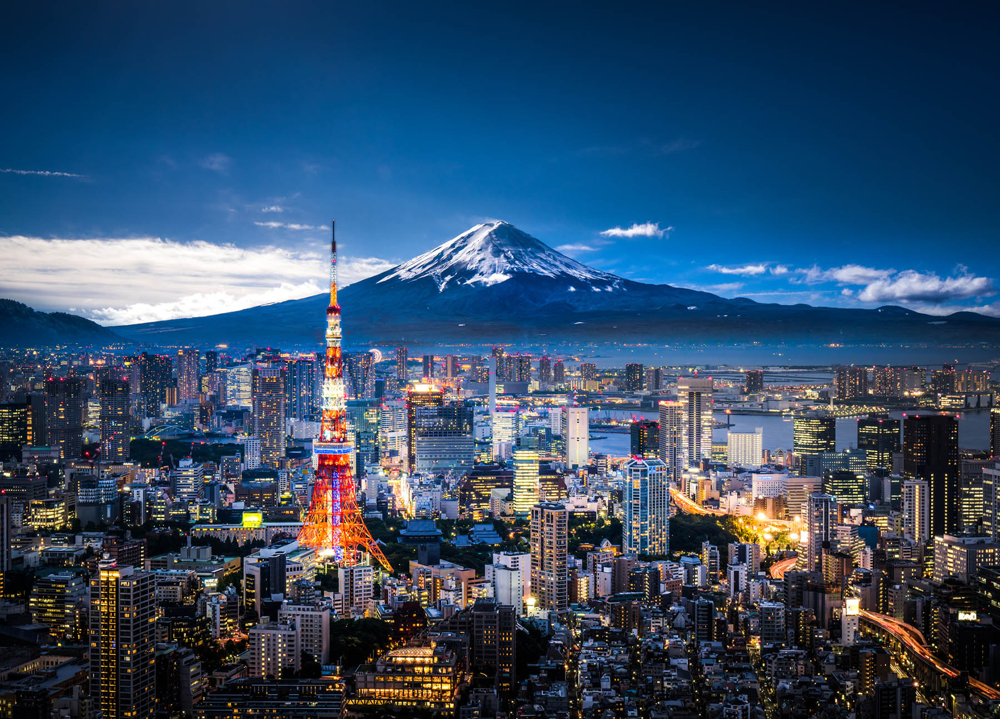

In [6]:
# Photo Source: https://wedc.org/blog/governor-evers-will-lead-trade-mission-
# to-japan-in-september/mt-fuji-and-tokyo-skyline/
Image(filename='Tokyo-Japan-skyline.jpg')

## Executive Summary

The start up boom has given birth to the shared economy – a system based on people sharing resources or services for a price, and potentially leveraging on the Internet to scale.  One of the most successful global examples of this is Airbnb – which has redefined and disrupted the hospitality and real estate industry by allowing hosts to list their properties for guests to book.  Airbnb distinguishes their hosts as Superhosts and Non-Superhosts, and this study focuses on Tokyo, Japan and draws data from InsideAirbnb.com to explore the relationships of listing characteristics, and comparing and contrasting them between these types of hosts. Throughout the paper, we apply data visualization, exploratory data analysis, hypothesis testing and dimensionality reduction techniques.  After these different approaches, the resulting hypothesis testing suggests that Superhost listings tend to be priced higher, and receive better overall reviews than the Non-Superhost counterparts.  Further, it appears that Superhosts’ have been hosting longer and their listings are occupied more frequently compared to Non-Superhosts, based on EDA results.  However, PCA does not seem to show any strong differentiation between Superhosts and Non-Superhosts – and it seems the real differentiator for the host types is mostly being able to comply with Airbnb’s Superhost requirements. 

## Introduction

From futuristic entertainment to old temples, Japan has always been a hotspot destination for travelers from around the world. In 2019, the Japan Tourism Agency said over 31.9 million overseas tourists visited the country.  Tourists can consider staying in capsule hotels or traditional ryokans, but others have found practical value in booking Airbnb accommodations instead for their cost and convenience, particularly in an expensive city like Tokyo. Tourists may also look at several factors, including the host status, which may have been influenced by certain listing characteristics.

**What is a Superhost?**

Superhosts are experienced hosts who provide a shining example for other hosts, and extraordinary experiences for their guests. Once a host reaches Superhost status, a badge will automatically appear on their listing and profile to help prospective guests identify them. Quarterly reviews are done on all hosts to reward them of this sought-after badge.

Superhost status is awarded to hosts that meet the following requirements:

* Completed at least 10 trips or 3 reservations that total at least 100 nights;
* Maintained a 90% response rate or above;
* Maintained a cancellation rate of 1% or below; and
* Maintained, at least, a 4.8 overall rating

## Problem Statement

This study explores the relationships of listing characteristics, and comparing, and contrasting them between Superhosts and Non-Superhosts. We aim to unfold, little by little, the interactions of the Airbnb features and identify which specific characteristics stand out or can be grouped together.

We will apply data visualization, exploratory data analysis, hypothesis testing and dimensionality reduction techniques to scrutinize the data characteristics.

## Methodology

This study consisted of various stages, giving focus on Exploratory Data Analysis (EDA) and dimensionality reduction techniques.

The steps will be described and illustrated in greater detail throughout this report, with the following summary:

1. Convert readily-available web-scraped data as at 20July2021
2. Manipulate, clean and save data as `csv`
3. Execute Exploratory Data Analysis through descriptive statistics, plots, tables, and charts
4. Perform Inferential Statistics to test differences in distribution between Superhosts and Non-Superhosts in terms of price and overall experience rating
5. Apply Principal Components Analysis on the data and explore the relationships, similarities or dissimilarities on how data points and features interact with the principal components 

Through these, we to glean insights, compare, and contrast Airbnb listings belonging to both Superhosts and Non-Superhosts.

## Data

### Data Source

**Airbnb**

Airbnb started when two hosts welcomed three guests to their San Francisco home in 2007. Friends, Brian Chesky and Joe Gebbia thought of setting up an air mattress in their living room and turn it into a bed and breakfast. Airbed & Breakfast, now popularly known as Airbnb, was established in 2008 as an online marketplace for lodging, homestays for vacation rentals, and tourism activities. Since then it has grown to 4 million Hosts and welcomed more than 900 million guest arrivals all over the world. As of September 2020, Airbnb has 5.6 million listings over 100,000 cities around the globe.

Airbnb started its operations in Japan in 2013 and has grown rapidly since. However, in 2018, a new homesharing law called `minpaku` required hosts to register and secure permits from the government that caused listings to decrease by up to 80%, from around 60,000. It recovered the following year and raised listings to around 50,000, and additional 23,000 rooms in traditional hospitality categories like hotels and Ryokans. The COVID-19 pandemic has impacted utilization of Airbnb's globally and may slowly recover as the world improves vaccination rates and ease travel restrictions.

**InsideAirbnb.com**

Inside Airbnb is a watchdog website that scrapes and analyzes publicly available information from Airbnb's website. Founded by Murray Cox, InsideAirbnb provides data as well as insights on how Airbnb competes not just with the hotel industry, but also with the residential housing market.

### Data Extraction and Preparation

The data set was extracted from the readily-available raw webscraped information as of 20July2021 from the Airbnb website. This can be accessed via $Jojie$ at `/mnt/data/public/insideairbnb/data.insideairbnb.com/japan/kantō/tokyo/`. Some fields from the original data set were manipulated to retain numeric values, while some were re-assigned with values (i.e. Superhost and Non-Superhost tagging). 

After selecting fields of interest to be used in this study and dropping lines with missing values, 2 data sets were produced:
1. `airbnb20210720.csv` as the main data set with 6,617 rows. One of these has a `minimum_nights` value of 999 and will be dropped in the succeeding sections, but will be added back in the PCA section.
2. `OH_superhost20210720.csv` which contains the boolean host type tagging (0 for Non-Superhost and 1 for Superhost).

The following table details the fields included in this study.

In [7]:
# The data preparation steps have been commented out in this notebook.
# For EDA, and dimensionality reduction, the processed data sets saved as csv
# file will be imported instead.
lr_select = pd.read_csv('airbnb20210720.csv', index_col=0)
OH_superhost = pd.read_csv('OH_superhost20210720.csv', index_col=0)

# Extract sole line with `minimum_nights` = 999
min_nights_outlier = lr_select[(lr_select.minimum_nights >= 999)]
# Drop row with minimum_nights = 999
lr_select = lr_select[(lr_select.minimum_nights < 999)].dropna()

<center><font size="3"><b>Table 1. Data Set Fields</b></font>
    
|#|Column|Non-Null Count|Dtype|Description
|:---|:------|:----|:-----|:----
|0|name|6616|object|Listing name
|1|host_id|6617|object|Host ID
|2|host_name|6618|object|Host Name
|3|host_is_superhost|6616|object|Re-tagged host type (Superhost/Non-Superhost)
|4|host_listings_count|6616|float64|Total listings under the same host
|5|latitude|6616|float64|Latitude coordinate
|6|longitude|6616|float64|Longitude coordinate
|7|property_type|6616|object|Property Type
|8|room_type|6616|object|Room Type
|9|accommodates|6616|int64|Capacity (per number of pax) of listing
|10|bedrooms|6616|float64|Count of bedrooms in listing
|11|beds|6616|float64|Count of beds in listing
|12|price|6616|float64|Price of listing in Japanese Yean
|13|minimum_nights|6616|int64|Minimum number nights per booking
|14|maximum_nights|6616|int64|Maximum number of nights per booking
|15|availability_365|6616|int64|Listing availability in the last 365 days
|16|number_of_reviews|6616|int64|Number of customer reviews
|17|review_scores_rating|6616|float64|Overall Experience Rating (0 to 5, continuous)
|18|review_scores_accuracy|6616|float64|Accuracy Rating (0 to 5, continuous)
|19|review_scores_cleanliness|6616|float64|Cleanliness Rating (0 to 5, continuous)
|20|review_scores_checkin|6616|float64|Check-in Process Rating (0 to 5, continuous)
|21|review_scores_communication|6616|float64|Host Communication Rating (0 to 5, continuous)
|22|review_scores_location|6616|float64|Location Rating (0 to 5, continuous)
|23|review_scores_value|6616|float64|Value Rating (0 to 5, continuous)
|24|reviews_per_month|6616|float64|Number of customer reviews per month
|25|amenities_ct|6616|int64|Count of listed amenities
|26|days_as_host|6616|int64|Number of days as host as of scraping date
|27|bathrooms|6616|float64|Number of bathrooms in listing
|28|hrr|6616|float64|Host Response Rate

## Exploratory Data Analysis

<font size="3"><b>Figure 1. Tokyo AirBnb Map by Host Type</b>

In [8]:
# Geo Map of Listings
fig3 = Figure(width=950, height=550)

# Takeshita Street in Shinjuku as Center
m3 = fol.Map(location=[35.6713, 139.7048],
             tiles='cartodbpositron',
             zoom_start=11,
             prefer_canvas=True)

# Landmarks
markers = [('Tokyo Imperial Palace', [35.6838, 139.7507], 'flag'),
           ('Tokyo Station', [35.6814, 139.7661], 'star-empty'),
           ('Tokyo Tower', [35.6586, 139.7454], 'tower'),
           ('Tokyo Skytree', [35.7101, 139.8107], 'camera'),
           ('Senso-ji Temple', [35.7148, 139.7967], 'camera'),
           ('Takeshita Street', [35.6713, 139.7048], 'camera'),
           ('Shinjuku Gyoen National Garden', [35.6852, 139.7101], 'camera'),
           ('Ikebukuro Station', [35.7295, 139.7109], 'star-empty'),
           ('Tokyo Metropolitan Government Building', [35.6896, 139.6921],
            'flag'),
           ('Shibuya Station', [35.6580, 139.7016], 'star-empty'),
           ('Don Quixote Akihabara', [35.7008, 139.7718], 'shopping-cart'),
           ('Tokyo Haneda Airport', [35.5494, 139.7798], 'plane')]

# Plotting the landmark markers onto the map
for i in markers:
    fol.Marker(location=i[1],
               popup=i[0],
               tooltip=i[0],
               icon=fol.Icon(color='darkblue',
                             icon=i[2])).add_to(m3)
fig3.add_child(m3)

superhost = dict()

# For map ticker
for s in pd.unique(lr_select['host_is_superhost']):
    superhost[s] = fol.FeatureGroup(name=s)

# Mean and standard deviation of price - for outlier markers
price_mean = lr_select.price.mean(axis=0)
price_std = lr_select.price.std(axis=0)

# Plotting the data points on the map
for i, r in lr_select.iterrows():
    if r.host_is_superhost == 'Superhost':
        if r.price > price_mean + 3 * price_std:
            c = 'magenta'
        else:
            c = 'red'
    elif r.host_is_superhost == 'Non-Superhost':
        if r.price > price_mean + 3 * price_std:
            c = 'cyan'
        else:
            c = 'blue'
    else:
        c = 'green'

    if r.price > price_mean + 3 * price_std:
        rad = 25
    else:
        rad = 15

    popup_string = ('NAME: ' + r['name'] +
                    f'\nHOST: {r.host_name}\nHOST ID: {r.host_id}')
    m = fol.Circle([r.latitude, r.longitude],
                   radius=rad,
                   color=c,
                   fill_color=c,
                   popup=popup_string,
                   tooltip='¥{:,.2f}'.format(r['price']))
    m.add_to(superhost[r.host_is_superhost])

for s in pd.unique(lr_select['host_is_superhost']):
    superhost[s].add_to(m3)

fol.LayerControl().add_to(m3)
m3

A map, with markers showing listing prices would be the welcome scene in Airbnb's accommodation search screen. It showcases the Superhost listings in <font color='red'>red dots</font>, and Non-Superhost listings in <font color='blue'>blue dots</font>. The reader may zoom in on the map, choose which points to show by host type by clicking on the tile icon found on the upper right corner. Also, the reader may hover over the dots to see the prices and click on them to see the listing name.

Listings tend to clump around the famous neighborhoods around Tokyo, such as:
* Asakusa-Akihabara area, where Tokyo Skytree and Senso-ji are located
* Shinjuku Area
* Ikebukuro

Based on the map, Superhost and Non-Superhost listings do not seem to dominate one or the other in terms of location. Some listings that are near each other also interestingly could belong to the same hosts.

You will notice dots in <span style='background:gray; opacity:0.5'><font color='cyan'>cyan</font></span> and <span style='background:gray; opacity:0.5'><font color='magenta'>magenta</font></span>. These are listings with prices exceeding three standard deviations above the mean price. The succeeding table shows a summary of these outlying listings in terms of price.


<font size="3"><b>Table 1. Price Outliers</b></font>

In [9]:
# Price Outliers
display(lr_select[lr_select.price > price_mean + 3 * price_std].
        pivot_table(index='host_is_superhost',
                    values='price', aggfunc=['count', 'min', 'max']))

,count,min,max
,price,price,price
host_is_superhost,,,
Non-Superhost,43,145714.0,1000000.0
Superhost,28,145714.0,600000.0


Descriptive statistics for the whole data set were obtained as an initial step in the exploratory data analysis (EDA). The standard deviation of price is higher than the mean.  Hence, only positive-side outliers can be noted. There are also other features that have outliers, when the 3-standard-devations rule is applied. However, these were not excluded from the study data set.

<font size="3"><b>Table 2. Descriptive Statistics of Features</b></font>

In [10]:
# Exploratory Data Analysis
# Show all columns of data sets
pd.set_option('display.max_columns', None)
lr_select.describe()

,host_id,host_listings_count,latitude,longitude,accommodates,bedrooms,beds,price,minimum_nights,maximum_nights,availability_365,number_of_reviews,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,reviews_per_month,amenities_ct,days_as_host,bathrooms,hrr
count,6.616000e+03,6616.000000,6616.000000,6616.000000,6616.000000,6616.000000,6616.000000,6616.000000,6616.000000,6616.000000,6616.000000,6616.000000,6616.000000,6616.000000,6616.000000,6616.000000,6616.000000,6616.000000,6616.000000,6616.000000,6616.000000,6616.000000,6616.000000,6616.000000
mean,1.791503e+08,13.872430,35.695978,139.736214,4.644800,1.493047,2.756802,17451.577842,2.398881,617.417624,160.602328,33.837515,4.678427,4.749651,4.674819,4.807588,4.804347,4.696398,4.653671,1.199119,26.269952,1333.912636,1.289828,0.971386
std,1.115968e+08,20.350802,0.042306,0.073850,3.118503,1.083490,2.445836,41883.626060,4.573451,481.528319,114.136420,45.961136,0.381428,0.366880,0.431053,0.313443,0.354629,0.336443,0.354858,1.198459,8.044527,696.105988,0.863250,0.118748
min,7.716940e+05,0.000000,35.540750,139.129360,1.000000,1.000000,0.000000,1050.000000,1.000000,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.020000,1.000000,27.000000,0.000000,0.000000
25%,6.832835e+07,2.000000,35.683878,139.701340,2.000000,1.000000,1.000000,5000.000000,1.000000,90.000000,72.000000,5.000000,4.560000,4.670000,4.570000,4.750000,4.750000,4.570000,4.540000,0.410000,21.000000,785.000000,1.000000,1.000000
50%,1.850640e+08,7.000000,35.702670,139.732535,4.000000,1.000000,2.000000,9000.000000,1.000000,365.000000,149.000000,17.000000,4.770000,4.850000,4.800000,4.900000,4.900000,4.770000,4.710000,0.920000,26.000000,1188.500000,1.000000,1.000000
75%,2.645975e+08,18.000000,35.720363,139.788695,6.000000,2.000000,4.000000,17250.000000,2.000000,1125.000000,252.000000,44.000000,4.910000,4.970000,4.960000,5.000000,5.000000,4.930000,4.870000,1.600000,31.000000,1915.000000,1.500000,1.000000
max,4.088362e+08,129.000000,35.830640,139.911580,16.000000,30.000000,56.000000,1000000.000000,60.000000,1125.000000,365.000000,489.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,23.440000,68.000000,3670.000000,24.000000,1.000000


<font size="3"><b>Figure 2. EDA Dashboard</b></font>

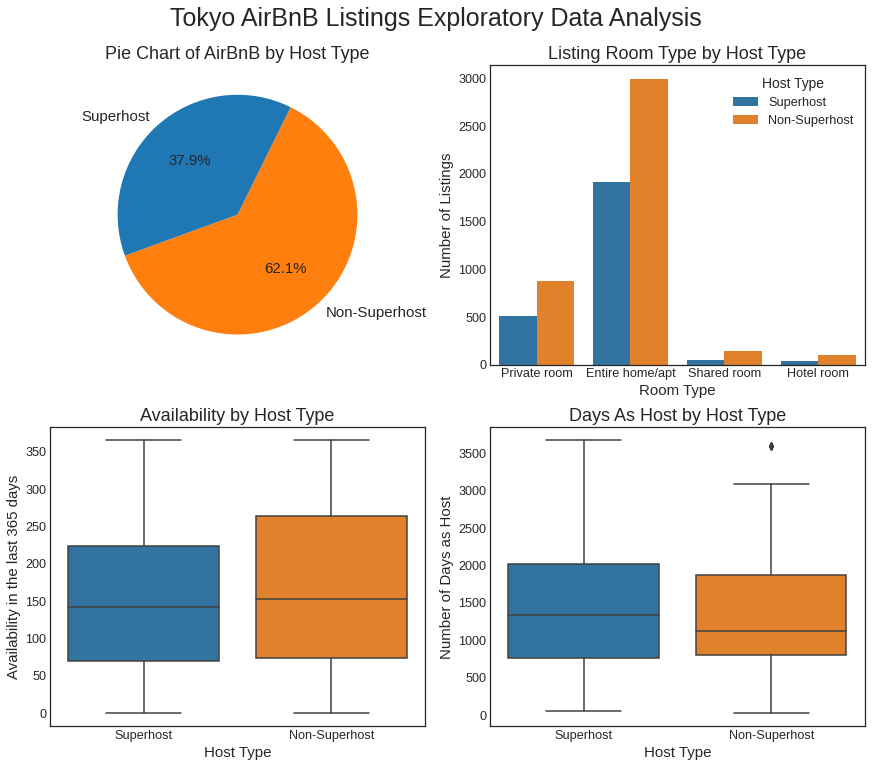

In [11]:
# Dashboard
sns.set_context('notebook', font_scale=1.15)
plt.style.use('seaborn-white')
fig = plt.figure(constrained_layout=True, figsize=(12, 10))
fig.suptitle('Tokyo AirBnB Listings Exploratory Data Analysis',
             fontsize=25, y=1.05)
gs = fig.add_gridspec(4, 4)
ax0 = fig.add_subplot(gs[0:2, :2])
ax1 = fig.add_subplot(gs[0:2, 2:])
ax2 = fig.add_subplot(gs[2:4, :2])
ax3 = fig.add_subplot(gs[2:4, 2:])

# Pie Chart
ax0.pie(lr_select.host_is_superhost.value_counts(),
        labels=lr_select.host_is_superhost.value_counts().index,
        autopct='%1.1f%%',
        startangle=-160,
        colors=['tab:orange', 'tab:blue'],
        textprops={'fontsize': 15})
ax0.set_title('Pie Chart of AirBnB by Host Type', fontsize=18)

# Countplot - Room Type
sns.countplot(x=lr_select.room_type,
              hue=lr_select.host_is_superhost,
              ax=ax1)
ax1.set_title('Listing Room Type by Host Type', fontsize=18)
ax1.set_xlabel('Room Type', fontsize=15)
ax1.set_ylabel('Number of Listings', fontsize=15)
ax1.legend(title='Host Type')

# Box Plot - Availability
sns.boxplot(data=lr_select,
            x='host_is_superhost',
            y='availability_365',
            ax=ax2)
ax2.set_title('Availability by Host Type', fontsize=18)
ax2.set_xlabel('Host Type', fontsize=15)
ax2.set_ylabel('Availability in the last 365 days', fontsize=15)

# Box Plot - Days as Host
sns.boxplot(data=lr_select,
            x='host_is_superhost',
            y='days_as_host',
            ax=ax3)
ax3.set_title('Days As Host by Host Type', fontsize=18)
ax3.set_xlabel('Host Type', fontsize=15)
ax3.set_ylabel('Number of Days as Host', fontsize=15)
plt.show()

* Majority of the listings belong to Non-Superhosts.
* Majority of listings are `Entire home/apt`. It appears that room type distributions of the host types are quite similar to each other.
* Distribution of availability in the last 365 days for Superhosts seems right-skewed. Non-Superhost listings availability seems to have a wider distribution and appears to have more available days as compared to Superhost listings.
* In terms of hosting tenure, listings from Superhosts have a wider range and distribution than those from Non-Superhosts. Superficially, the plot seems to support the idea that earning a Superhost tag takes time. The outliers from the Non-Superhost group are 4 listings from the same host who has been with Airbnb for 3,597 days as of 20July2021.


<font size="3"><b>Figure 3. Price Heat Map - Non-Superhost, Excluding Outliers</b></font>

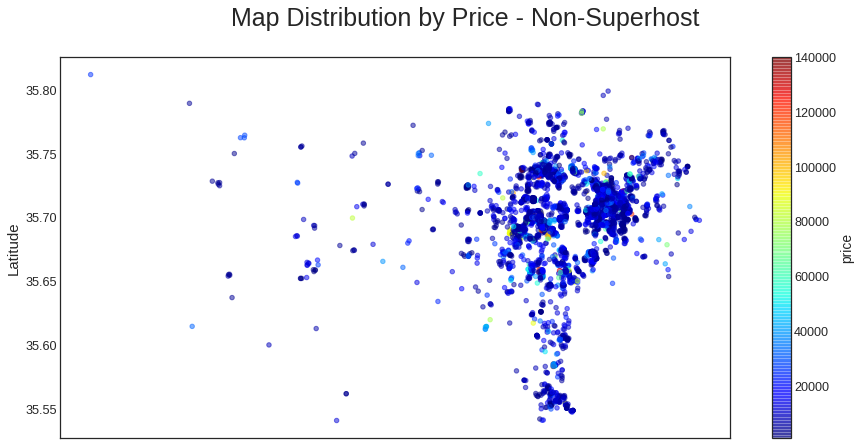

In [12]:
# Price Heatmap - Non-Superhost (excluding outliers)
plt.style.use('seaborn-white')
(lr_select[(lr_select.host_is_superhost == 'Non-Superhost') &
           (lr_select.price <= price_mean + 3 * price_std)].
 plot(kind='scatter',
      x='longitude',
      y='latitude',
      label='id',
      c='price',
      cmap=plt.get_cmap('jet'),
      colorbar=True,
      alpha=0.5,
      figsize=(15, 7),
      legend=None))
plt.suptitle("Map Distribution by Price - Non-Superhost", fontsize=25)
plt.xlabel("Longitude", fontsize=15)
plt.ylabel("Latitude", fontsize=15)
plt.show()

* The map is dominated by dark blue dots, suggesting relatively prices with reference to color shade.
* The area or district does seem to have any effect on price since there are no concentrated specs of lighter or hotter colors.
* Listings on the sparser side of the map seem to have higher prices relative to those on the more dense areas, where there is more competition and options.
* On the surface, the lighter specs appear to be spread out randomly throughout Tokyo.

<font size="3"><b>Figure 4. Price Heat Map - Superhost, Excluding Outliers</b>

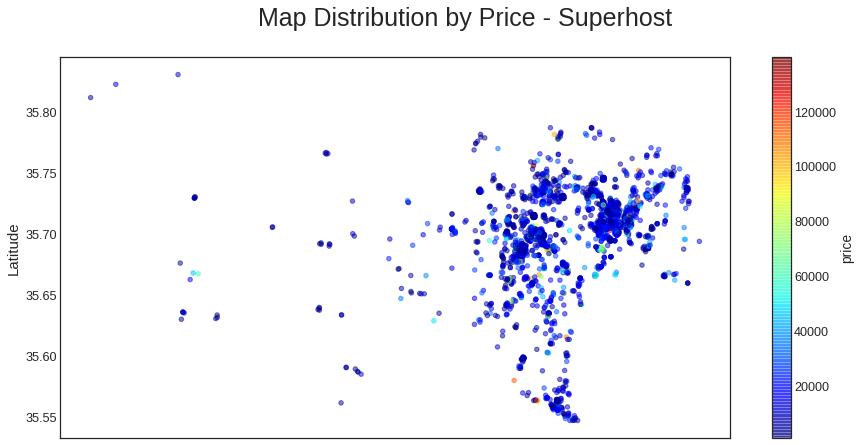

In [13]:
# Price Heatmap - Superhost (excluding outliers)
plt.style.use('seaborn-white')
(lr_select[(lr_select.host_is_superhost == 'Superhost') &
           (lr_select.price <= price_mean + 3 * price_std)].
 plot(kind='scatter',
      x='longitude',
      y='latitude',
      label='id',
      c='price',
      cmap=plt.get_cmap('jet'),
      colorbar=True,
      alpha=0.5,
      figsize=(15, 7),
      legend=None))
plt.suptitle("Map Distribution by Price - Superhost", fontsize=25)
plt.xlabel("Longitude", fontsize=15)
plt.ylabel("Latitude", fontsize=15)
plt.show()

* Similar to Non-Superhosts, it appears that area or district does not have an effect on listing price.
* Lighter to hotter colors do not seem to bundle up in certain spots, and are actually well spread-out on the map.
* The listings west of central Tokyo, though widely spread out, seem to have higher prices.

Further, there does not seem to have any distinct difference on price-to-area spread of listings between those of Superhosts and Non-Superhosts.


<font size="3"><b>Table 3. Mean Ratings Per Category</b></font>

In [14]:
# Polar Plots By Review Scores
scores_df = lr_select[['host_is_superhost',
                       'review_scores_rating',
                       'review_scores_accuracy',
                       'review_scores_cleanliness',
                       'review_scores_checkin',
                       'review_scores_communication',
                       'review_scores_location',
                       'review_scores_value']]

scores_df = scores_df .groupby('host_is_superhost').mean().reset_index()
scores_df = scores_df.T.iloc[1:, :].rename(columns={0: 'Non-Superhost',
                                                    1: 'Superhost'})
display(scores_df)

,Non-Superhost,Superhost
review_scores_rating,4.591185,4.821601
review_scores_accuracy,4.686419,4.853421
review_scores_cleanliness,4.587402,4.818279
review_scores_checkin,4.764488,4.878319
review_scores_communication,4.750956,4.891968
review_scores_location,4.664841,4.748188
review_scores_value,4.603768,4.735569


**How do Airbnb ratings work?**

On top of written reviews, guests can also evaluate their whole experience by giving star ratings, ranging from 0 to 5. These are then aggregated and summarized by Airbnb to be available to the hosts, and even get posted on their listing profiles.

These are the categories, and things that guests need to keep in mind as they give ratings:
* <i><b>Overall Experience</b></i>
    - How was it?
* <i><b>Accuracy</b></i>
    - Are the posted details, photos, and information accurate and up to date?
* <i><b>Cleanliness</b></i>
    - Did the listing meet Airbnb's cleanliness standards?
* <i><b>Check-in</b></i>
    - Was it easy and seamless?
* <i><b>Communication</b></i>
    - Did the host respond to guest queries promptly?
* <i><b>Location</b></i>
    - Was the guest made aware of safety, transportation, points of interest and special considerations like
    noise or other situations that might affect their stay?
* <i><b>Value</b></i>
    - Was it worth the price?
    
**Ratings Validation and Counter-Check Measures**
    
According to Airbnb's website, they have launched a tool that validates and detects outlier reviews or one-off bad reviews, as response to feedback from hosts. A sample scenario would be high scores across categories, but a 2-star rating on Overall Experience. When this happens, the guest receives a notification and enables them to revisit and change their review ratings.

The same step is done with Location and Value ratings, which happens when guests rate a listing with less than 3 stars. The guest will receive a notification to further probe the reason for the low rating by asking the following questions, respectively:
* Was the listing not described accurately?
* What would have made this listing a better value?
    
Airbnb took these extra steps, especially for Location, since hosts raised issues on being penalized on a rating aspect that is out of their control.

**How do Superhost and Non-Superhost listings compare on ratings?**

A cursory check would suggest that Superhost listings perform better than those of Non-Superhosts, based on ratings. It might be expected as well, since the automatic Superhost status requires at least a 4.8 Overall Experience Rating. However, one might not be able to gauge if there is significant difference between the scores. How different is as 4.5 versus a 4.8? We shall explore this further in the succeeding sections.

In [15]:
# Selected fields for correlation analysis and dimensionality reduction
fields_corr = ['hrr',
               'host_listings_count',
               'latitude',
               'longitude',
               'accommodates',
               'bathrooms',
               'bedrooms',
               'beds',
               'amenities_ct',
               'days_as_host',
               'price',
               'minimum_nights',
               'availability_365',
               'review_scores_rating',
               'review_scores_accuracy',
               'review_scores_cleanliness',
               'review_scores_checkin',
               'review_scores_communication',
               'review_scores_location',
               'review_scores_value',
               'number_of_reviews']

## Correlations of Features

It would be interesting to see how these features behave with each other linearly, so correlation heat maps were produced. We will follow below heuristic as we examine and interpret these linear relationships.

<br></br>
<center><font size="2.5"><b>Table 4. Correlation Coefficient Interpretation</b></font></center>

|Correlation Coefficient|Interpretation of Linear Relationship|
|:---|:---|
|r = -1|Perfect negative|
|-1 < r <= -0.7|Strong negative|
|-0.7 < r <= -0.3|Moderate negative|
| -0.3 < r < 0|Weak negative|
|r = 0|No relationship|
|0 < r <  0.3|Weak positive|
|0.3 <= r < 0.7|Moderate positive|
|0.7 <= r < 1|Strong positive|
|r = 1|Perfect positive|

<font size="3"><b>Figure 6. Correlation Heat Map - Non-Superhost</b>

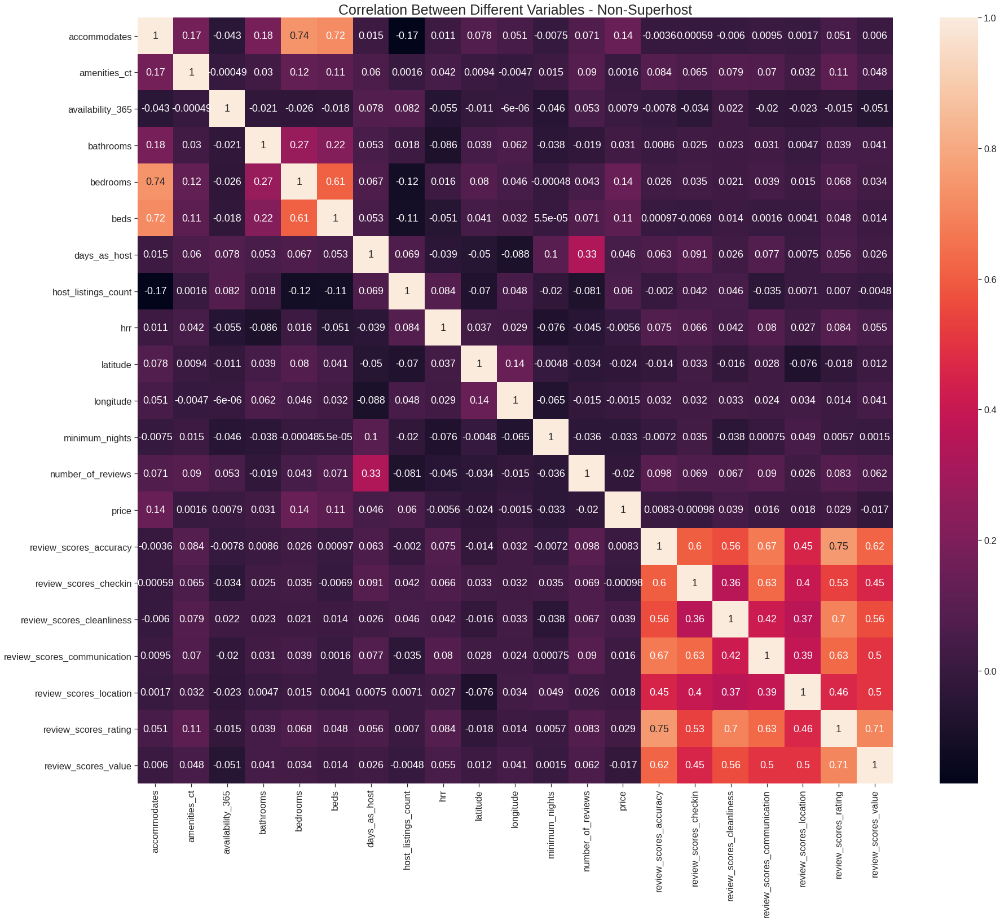

In [16]:
# Correlation heatmap - Non-Superhost
corr_data = lr_select[lr_select.host_is_superhost == 'Non-Superhost']
sns.set_context('notebook', font_scale=1.5)
corr = corr_data[sorted(fields_corr)].corr()
plt.figure(figsize=(30, 25))
plt.title("Correlation Between Different Variables - Non-Superhost",
          fontsize=25)
sns.heatmap(corr, annot=True)
plt.show()

An initial glance would draw one's attention to the review scores, having the hotter colors. Though they measure different facets of a guest's stay, it is quite expected of them to be positively correlated, as discussed in the previous section.


**Review Scores**
* The scores show moderate to strong positive linear relationships with each other.
* The strongest positive linear relationship between review scores can be seen between `review_scores_rating` and `review_scores_accuracy`. While the weakest can be seen between `review_scores_cleanliness` and `review_scores_checkin`.
* As discussed in the previous section, it is not surprising to see that among all review scores, the `review_scores_rating` has the weakest linear relationship with `review_scores_location`. This is where hosts usually have issues with reviews.



**Notable Correlations**
* <i>"Capacity"</i> features such as, `accommodates`, `bedrooms`, and `beds` have moderate to strong positive linear relationships with each other.
* Number of reviews tends to increase over time. Though true for above, the relationship between `number_of_reviews` and `days_as_host` is weak.

<font size="3"><b>Figure 7. Correlation Heat Map - Superhost</b>

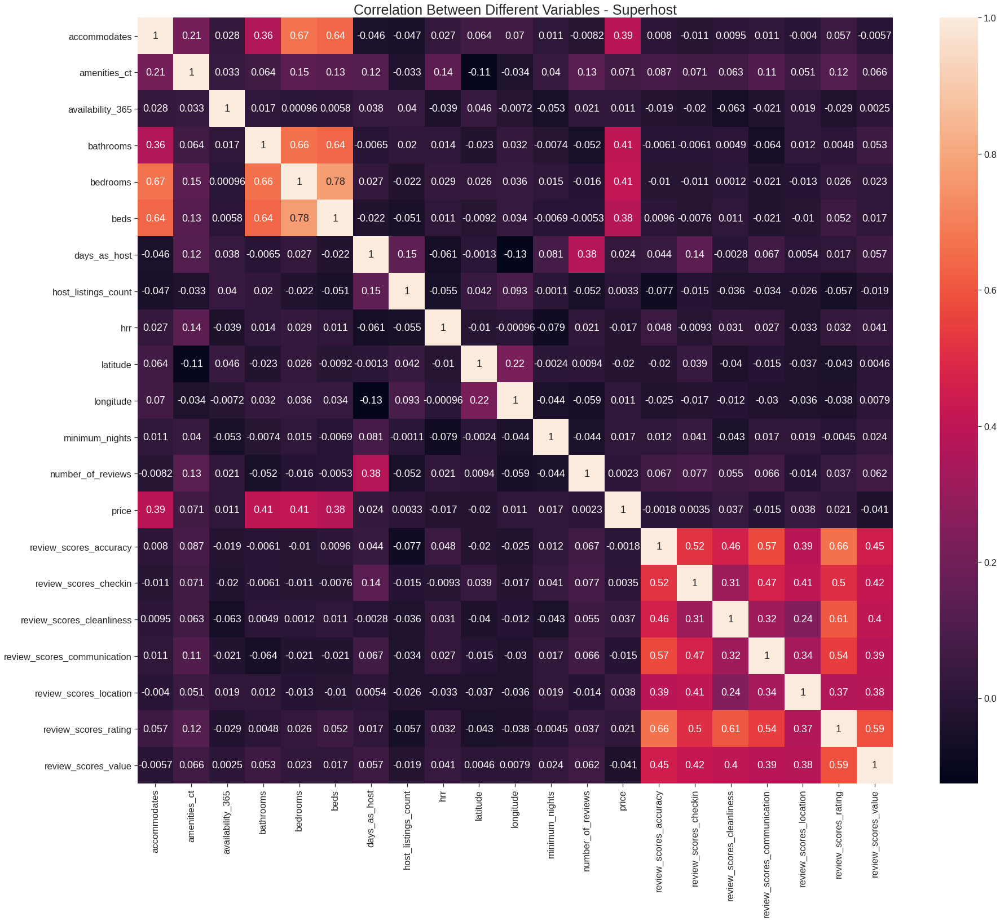

In [17]:
# Correlation Heatmap - Superhost
corr_data = lr_select[lr_select.host_is_superhost == 'Superhost']
sns.set_context('notebook', font_scale=1.5)
corr = corr_data[sorted(fields_corr)].corr()
plt.figure(figsize=(30, 25))
plt.title("Correlation Between Different Variables - Superhost",
          fontsize=25)
sns.heatmap(corr, annot=True)
plt.show()

Similar to Non-Superhosts, all review scores show positive linear relationship with each other. However, the relationships appear to be weaker. This goes against the thinking that since Superhost listings are expected to maintain higher ratings, then review score relationships should be stronger. This may be worth investigating further, but already beyond the scope of this study.

The linear relationship of `accommodates` to `beds` and `bedrooms` seem to be weaker for Superhosts, but positive correlations between `bed` and `bedrooms` have become stronger. Superhosts might have less beds per bedroom in their listings or that more of these listings follow a one-bed-one-bedroom set-up. `bathrooms` also showed a much stronger relationship with `bedrooms` and `beds`.

Another notable difference would be the relationship of `price` with `bathrooms`, `beds`, and `bedrooms` that has become stronger for Superhost listings.

## Hypothesis Testing

Combing through the data, one might ask: Is there a price difference between Superhost and Non-Superhost listings? Does the tagging mean that Superhost listings are priced relatively more expensive than those of Non-Superhosts, or vice versa? On customer reviews, which group has higher ratings? These may be answered by doing hypothesis testing.

We further investigate the distributions of these features before we proceed in comparing the two groups.

<font size="3"><b>Figure 8. KDE Plots of Price and Overall Experience Review Score</b>

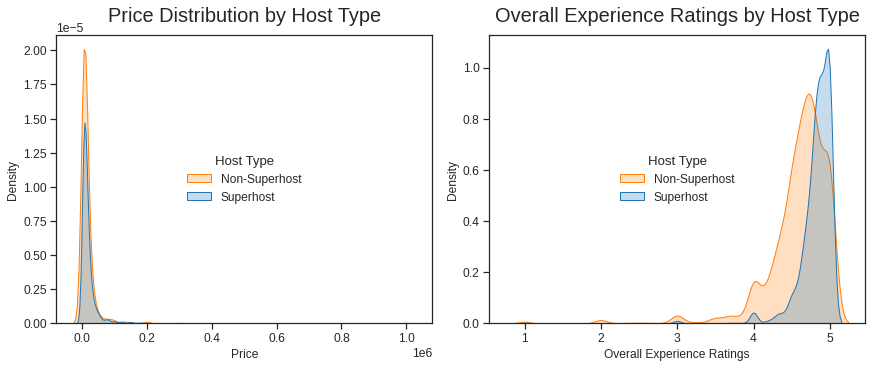

In [18]:
plt.style.use('seaborn-white')
sns.set_context('notebook', font_scale=1.1)
fig = plt.figure(constrained_layout=True, figsize=(12, 5))
gs = fig.add_gridspec(1, 2)
ax0 = fig.add_subplot(gs[:, :1])
ax1 = fig.add_subplot(gs[:, 1:])

# KDE Plot of Price by Host Type
sns.kdeplot(data=lr_select,
            x='price',
            hue='host_is_superhost',
            fill=True,
            legend=False,
            ax=ax0)
ax0.legend(title='Host Type',
           labels=['Non-Superhost', 'Superhost'],
           loc='center',
           fontsize=12)
ax0.set_title('Price Distribution by Host Type', fontsize=20, y=1.025)
ax0.set_xlabel('Price', fontsize=12)
ax0.set_ylabel('Density', fontsize=12)

# KDE Plot of Overall Experience Rating by Host Type
sns.kdeplot(data=lr_select,
            x='review_scores_rating',
            hue='host_is_superhost',
            fill=True,
            legend=False,
            ax=ax1)
ax1.legend(title='Host Type',
           labels=['Non-Superhost', 'Superhost'],
           loc='center',
           fontsize=12)
ax1.set_title('Overall Experience Ratings by Host Type', fontsize=20, y=1.025)
ax1.set_xlabel('Overall Experience Ratings', fontsize=12)
ax1.set_ylabel('Density', fontsize=12)
plt.show()

The KDE graphs show that `price` and `review_scores_rating` are asymmetric, for both host types. In order to guide us with which test to implement, let's test first if they are `normally distributed`.

**Tests of Normality**

Normality tests are used to determine if the sample data has been drawn from a normally-distributed population. In this study, we used three general normality tests, namely:

* Anderson-Darling - a modification of the Kolmogorov-Smirnov (K-S) test and gives more weight to the tails than does the K-S test.
* Shapiro-Wilk - small values of this statistic are evidence of departure from normality.
* D'Agostino's $K^2$ - dubbed as an omnibus test for normality that uses Skewness and Kurtosis.

Both Anderson-Darling and Shapiro-Wilk are affected by ties, but D'Agostino's $K^2$ is not. In the succeeding section, we shall test the following hypotheses that `price`, and `review_scores_rating` for Superhosts and Non-Superhosts are normally-distributed, at 95% confidence level ($\alpha$= 0.05):  
<br ></br>
<center>$H_0$: The data follows a Normal Distribution</center>
<center>$H_1$: The data does not follow a Normal Distribution</center>

In [19]:
# Hypothesis testing for price and review scores
a = lr_select[lr_select.host_is_superhost == 'Superhost']['price']
b = lr_select[lr_select.host_is_superhost == 'Non-Superhost']['price']
c = (lr_select[lr_select.host_is_superhost == 'Superhost']
     ['review_scores_rating'])
d = (lr_select[lr_select.host_is_superhost == 'Non-Superhost']
     ['review_scores_rating'])

In [20]:
# Normality Testing
def normality(data, alpha=5):
    """Return a pandas.DataFrame of normality test results.

    Applies the following nomality tests:
        1. Shapiro-Wilk
        2. D'Agostino's K^2
        3. Anderson-Darling

    Parameters
    ----------
    data : pandas.DataFrame
        Data set to be tested

    alpha : int or float
        Level of significance in %

    Returns
    -------
    test_table : pandas.DataFrame
        Data frame containing test results
    """

    test_table = pd.DataFrame()
    tests = [shapiro, normaltest, anderson]
    names = ["Shapiro-Wilk", "D’Agostino’s K^2", "Anderson-Darling"]
    for i, t in enumerate(tests):
        test = names[i]
        if i < 2:
            stat, pvalue = t(data)
            critical = "N/A"
            if pvalue < alpha:
                decision = "Reject H0"
            else:
                decision = "Do Not Reject H0"
        else:
            ad = t(data)
            stat = ad.statistic
            pvalue = "N/A"
            try:
                critical = ad.critical_values[ad.significance_level.
                                              tolist().index(alpha)]
            except ValueError:
                critical = "N/A"

            if critical == "N/A":
                decision = "Invalid Alpha"
            elif stat > critical:
                decision = "Reject H0"
            else:
                decision = "Do Not Reject H0"

        test_table = pd.concat([test_table,
                                pd.DataFrame(
                                   {'Statistic': stat,
                                    'P-Value': pvalue,
                                    'Critical Value': critical,
                                    'Decision': decision},
                                   index=[names[i]])],
                               axis=0)
    return test_table

<font size="3"><b>Table 5. Test of Normality Results</b></font>

In [21]:
# For Price
print("1. PRICE - Superhost")
display(normality(a))
print("2. PRICE - Non-Superhost")
display(normality(b))

# For Overall Ratings
print("3. OVERALL EXPERIENCE RATINGS - Superhost")
display(normality(c))
print("4. OVERALL EXPERIENCE RATINGS - Non-Superhost")
display(normality(d))

1. PRICE - Superhost


,Statistic,P-Value,Critical Value,Decision
Shapiro-Wilk,0.436399,0.0,N/A,Reject H0
D’Agostino’s K^2,3416.568148,0.0,N/A,Reject H0
Anderson-Darling,363.080013,N/A,0.786,Reject H0


2. PRICE - Non-Superhost


,Statistic,P-Value,Critical Value,Decision
Shapiro-Wilk,0.209090,0.0,N/A,Reject H0
D’Agostino’s K^2,8053.241528,0.0,N/A,Reject H0
Anderson-Darling,903.442370,N/A,0.786,Reject H0


3. OVERALL EXPERIENCE RATINGS - Superhost


,Statistic,P-Value,Critical Value,Decision
Shapiro-Wilk,0.622831,0.0,N/A,Reject H0
D’Agostino’s K^2,2854.630234,0.0,N/A,Reject H0
Anderson-Darling,165.722508,N/A,0.786,Reject H0


4. OVERALL EXPERIENCE RATINGS - Non-Superhost


,Statistic,P-Value,Critical Value,Decision
Shapiro-Wilk,0.745486,0.0,N/A,Reject H0
D’Agostino’s K^2,2904.493101,0.0,N/A,Reject H0
Anderson-Darling,182.154382,N/A,0.786,Reject H0


The `p-values` from the Shapiro-Wilk and D'Agostino's $K^2$ tests are all less than 0.05, and the Anderson-Darling test statistic is higher than the critical value at 95% confidence level. Hence we reject $H_0$ for these tests, suggesting that prices and overall experience ratings of Superhost and Non-Superhost listings are not normally-distributed. This means that we cannot use parameteric tests, specifically the `t-test`, to see if there is significant difference in mean `price` and `review_scores_rating` between the host types.

**Mann-Whitney U Test**

The Mann-Whitney U test is a non-parametric test used to compare differences between two independent groups when the dependent variable (`price` and `review_scores_rating`) is either ordinal or continuous, but not normally distributed. It is often used as a test of difference in location between distributions.

We shall test the following, at 95% confidence level ($\alpha$=0.05):  
<br ></br>
<center>$H_0$: The distribution underlying $x$ is stochastically less than or equal to that of $y$</center>
<center>$H_1$: The distribution underlying $x$ is stochastically greater than that of $y$</center>

The variable $x$ will be assigned to the Superhost listings, and $y$ to Non-Superhost listings.

  <font size="3"><b>Table 4. Mann-Whitney U Test Results</b></font>

In [22]:
# Non-Parametric Hypothesis Testing of Price Distribution
# To test if price distribution of Superhost <= Non-Superhost
print("Mann-Whitney U Test p-value (price) =",
      mannwhitneyu(a, b, alternative='greater').pvalue)

# To test if OER distribution of Superhost <= Non-Superhost
print("Mann-Whitney U Test p-value (overall experience rating) =",
      mannwhitneyu(c, d, alternative='greater').pvalue)

Mann-Whitney U Test p-value (price) = 1.7145250634222524e-27
Mann-Whitney U Test p-value (overall experience rating) = 3.455169664020553e-199


Given that the resulting `p-values` after running the test to compare `price` and `review_scores_rating` between host types are less than $\alpha$, there is sufficient evidence to say the following, at 95% confidence level:

* The prices of listings from Superhosts tend to be higher than those from Non-Superhosts.
* Super hosts tend to receive higher overall experience ratings than Non-Superhosts.

## Dimensionality Reduction

Dimensionality reduction techniques are methods used to lessen the features of a data set by performing transformations on it, while aiming to preserve as much of the information as possible. Using the transformed data set is a trade-off between accuracy and simplicity since it would be easier to deal with a smaller data set, but with less information. These methods are highly useful in dealing with massive amounts of data, which can reduce computational requirements when further processed or analyzed. These can also help reveal latent data characteristics and relationships.

The Tokyo Airbnb data set is dense; hence we chose Principal Components Analysis. However, the data set has features that are of different scales.  However, the data set has features that are of different scales. To level the features, standardization is required before moving forward with dimensionality reduction.

We used `sklearn`'s `RobustScaler` to preprocess the data, given the observed outliers. `RobustScaler` removes the median of the feature and scales it with the inter-quartile range - that is, the difference between the $75th$ and $25th$ quartile values. The formula is shown below:  

## <center>$X_{scale} = \frac{x_i-x_{med}}{x_{75}-x_{24}}$</center>


### Scree and Explained Variance

In [23]:
# Dimension Reduction
# Use Robust Scaler since there are outliers in the data
X = preprocessing.RobustScaler().fit_transform(lr_select[fields_corr])
y = OH_superhost.squeeze()[lr_select.index]

pca = decomposition.PCA()
X = pca.fit_transform(X)

<font size="3"><b>Figure 9. Scree and Cumulative Explained Variance</b></font>

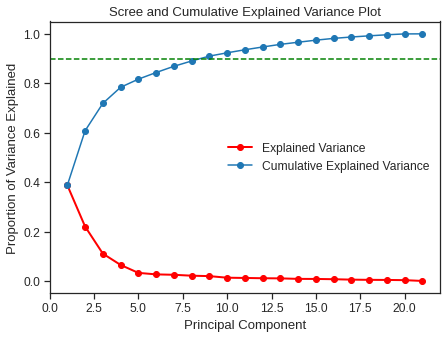

CUMULATIVE EXPLAINED VARIANCE:


,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21
Variances Explained,0.387436,0.60792,0.718727,0.783775,0.816704,0.843514,0.868712,0.890191,0.909956,0.923291,0.935625,0.946838,0.957492,0.966106,0.974423,0.981703,0.987254,0.99197,0.996294,0.99975,1.0


In [24]:
# Scree and Cumulative Explained Variance Plot - without minimum nights = 999
PC_values = np.arange(pca.n_components_) + 1
fig = plt.figure(figsize=(7, 5))
plt.plot(PC_values, pca.explained_variance_ratio_, 'ro-', linewidth=2)
plt.plot(PC_values,  pca.explained_variance_ratio_.cumsum(), 'o-')
plt.axhline(0.9, ls='--', color='g')
plt.legend(['Explained Variance', 'Cumulative Explained Variance'])
plt.title('Scree and Cumulative Explained Variance Plot')
plt.xlabel('Principal Component')
plt.ylabel('Proportion of Variance Explained')
plt.show()

# Cumulative Explained Variances
cum_exp_var = pd.DataFrame(
    pca.explained_variance_ratio_.cumsum(),
    columns=['Variances Explained'],
    index=range(1,
                len(pca.explained_variance_ratio_) + 1))
print('CUMULATIVE EXPLAINED VARIANCE:')
display(cum_exp_var.T)

After performing PCA, the 21-feature data set can be reduced to 9 principal components, which can explain approximately 91% of the total variances. That is a 57% reduction in total number of features.

### Aside: Outlier Sensitivity of PCA

<font size="3"><b>Figure 10. Scree and Cumulative Explained Variances For Data With <i>minimum_nights</i> Outlier</b></font>

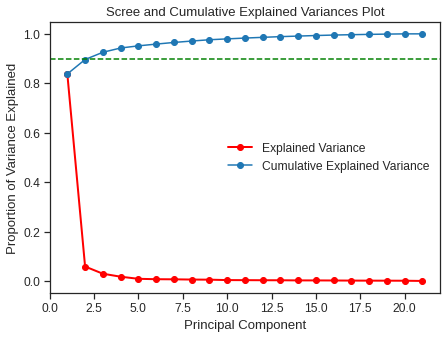

CUMULATIVE EXPLAINED VARIANCE:


,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21
Variances Explained,0.837688,0.896118,0.925456,0.942681,0.951401,0.958502,0.965178,0.970867,0.976115,0.979653,0.982932,0.985901,0.988726,0.991007,0.99321,0.995138,0.996623,0.997873,0.999018,0.999933,1.0


In [25]:
# PCA on data with sole outlier for minimum nights
X_o = (preprocessing.RobustScaler().
       fit_transform(pd.concat([lr_select[fields_corr],
                                min_nights_outlier[fields_corr]], axis=0)))
y_o = OH_superhost.squeeze()[lr_select.index]

pca_o = decomposition.PCA()
X_o = pca_o.fit_transform(X_o)

# Scree and Cumulative Explained Variances Plot - with minimum nights = 999
PC_values = np.arange(pca_o.n_components_) + 1
fig = plt.figure(figsize=(7, 5))
plt.plot(PC_values, pca_o.explained_variance_ratio_, 'ro-', linewidth=2)
plt.plot(PC_values,  pca_o.explained_variance_ratio_.cumsum(), 'o-')
plt.axhline(0.9, ls='--', color='g')
plt.legend(['Explained Variance', 'Cumulative Explained Variance'])
plt.title('Scree and Cumulative Explained Variances Plot')
plt.xlabel('Principal Component')
plt.ylabel('Proportion of Variance Explained')
plt.show()

# Cumulative Explained Variances
cum_exp_var = pd.DataFrame(pca_o.explained_variance_ratio_.cumsum(),
                           columns=['Variances Explained'],
                           index=range(1,
                                       len(pca_o.explained_variance_ratio_)
                                       + 1))
print('CUMULATIVE EXPLAINED VARIANCE:')
display(cum_exp_var.T)

Above graph shows how outliers can affect PCA. A single row having a `minimum_nights` value of 999 was added back to the main data set, then run through PCA. From 9 principal components needed to reach at least 90% of explained variances, this particular result only needed 3. This may seem like a good result, but may be misleading.

### Rotated Axis Plot

Note to reader: Below interactive graph may be rotated, panned, and zoomed-in/out for better view of the data points and their interactions with the principal components, as well as the features.

<font size="3"><b>Figure 11. Rotated Axis Plot of Listings and Feature Weights</b></font>

Dots in <span style='background:gray; opacity:0.5'><font color=yellow> yellow</font></span> are Superhost listings, while those in <span style='background:gray; opacity:0.5'><font color=purple>violet</font></span> are Non-Superhost listings.

In [29]:
X = preprocessing.RobustScaler().fit_transform(lr_select[fields_corr])
y = OH_superhost.squeeze()[lr_select.index]

# Principal Components
p1 = 0
p2 = 1
p3 = 2

# Apply PCA
pca = decomposition.PCA()
components = pca.fit_transform(X)

fig = go.Figure()
fig.update_layout(width=500, height=500)

# Plot the pointss
fig.add_trace(
    go.Scatter3d(x=components[:, p1],
                 y=components[:, p2],
                 z=components[:, p3],
                 mode='markers',
                 marker=dict(size=5,
                             color=y,
                             colorscale='Viridis',
                             opacity=0.8),
                 showlegend=False))

# Change Axis Labels
fig.update_layout(scene=dict(
    xaxis_title=f'PC{p1+1}',
    yaxis_title=f'PC{p2+1}',
    zaxis_title=f'PC{p3+1}'),
                  width=700,
                  margin=dict(r=20, b=10, l=10, t=10))

# Mean component values
mean_x = pca.components_[:, p1].mean()
mean_y = pca.components_[:, p2].mean()
mean_z = pca.components_[:, p3].mean()

# Plot the lines
for feature, vec in zip(fields_corr, pca.components_):
    fig.add_trace(go.Scatter3d(
        x=[mean_x, vec[p1]*50],
        y=[mean_y, vec[p2]*50],
        z=[mean_z, vec[p3]*50],
        mode='lines',
        showlegend=False,
        line=dict(color='orange')))

# Plot feature annotations
fig.update_layout(scene=dict(annotations=[dict(showarrow=False,
                                               x=vec[p1]*50,
                                               y=vec[p2]*50,
                                               z=vec[p3]*50,
                                               text=feature,
                                               textangle=0,
                                               xshift=10,
                                               opacity=1.0,
                                               font=dict(color='orange',
                                                         size=12))
                                          for feature,
                                          vec in zip(fields_corr,
                                                     pca.components_)]))
# Tight Layout
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.show(renderer='notebook')

<b><font size=3>Table 4. PCA Feature Weights Table</font></b>

The table better shows the relationship of the features to the first 3 principal components. 

In [27]:
ft = pd.DataFrame({feature: v for feature, v in zip(fields_corr,
                                                    pca.components_)})
ft.iloc[:3].T.sort_values(0).T

,number_of_reviews,review_scores_location,review_scores_cleanliness,availability_365,review_scores_rating,days_as_host,latitude,bathrooms,longitude,amenities_ct,hrr,review_scores_value,review_scores_checkin,host_listings_count,price,accommodates,review_scores_accuracy,bedrooms,minimum_nights,beds,review_scores_communication
0,-0.999631,-0.013299,-0.011433,-0.006931,-0.006009,-0.005198,-0.004997,-0.003418,-0.002879,-0.002847,-0.001858,-0.001834,-0.000678,-0.000282,0.000384,0.001919,0.001961,0.002518,0.005443,0.008973,0.011635
1,0.006204,-0.003938,-0.068069,-0.019462,-0.014998,-0.067883,0.043415,0.167198,-0.048312,-0.062715,-0.004942,-0.016085,-0.066206,0.016179,0.037591,0.815419,-0.003049,0.408998,-0.078797,0.330502,0.003866
2,0.002315,-0.002449,-0.035366,-0.092923,0.039526,-0.040023,0.004022,-0.719686,0.036973,0.218868,-0.001017,0.028110,-0.001041,-0.007338,0.228583,-0.094185,-0.046864,0.578447,-0.059363,-0.131130,-0.014855


The Superhost listings tend to gather at the base of the clusters in the graph while the peaks seem to be dominated by listings from Non-Superhosts. Moreover, the outliers on the rotated axis plot are mostly Non-Superhost listings. Aside from those mentioned, there seems to be no other notable difference in interaction with the features and principal components between Superhosts and Non-Superhosts.

Below are findings from the PCA results:

* Some clustering show up along PC1.
* `number_of_reviews` had an almost perfect negative relationship with PC1, where no other feature seems to show any notable relationship with. The direction where this dominant feature points to is a void. Further to that, `number of reviews` seems to be orthogonal to `accommodates`, `bedroom`, `beds`, and `bathrooms`.
* PC2 appears to give importance to physical features of the listings and guest capacity. The feature `accommodates` has a strong positive relationship with PC2, followed by `bedrooms`, `beds` then `bathrooms` which all show positive weights suggesting positive correlation with each other as well.
* PC3 and `bathroom` have a strong negative relationship. Similar to `number_of_reviews` in PC1, `bathroom` also points toward a void, probably due to the fact that most Japanese listings in Tokyo are small and would be less likely to have additional bathrooms in them. However, the succeeding features with relatively high weights - `bedrooms`, `price`, and `amenities_ct`, all affect PC3 positively. More listings move toward the direction of the latter 3 mentioned features as compared to all the highly dominant ones in in the first three principal components. This is apparent with the tallest pillar in the graph.



## Results and Discussion

* Cursory evaluation of EDA boxplots appears to suggest that Superhosts’ listings are occupied more frequently compared to Non-Superhosts.  Superhosts also seem to have been hosting longer than Non-Superhosts.
* The resulting hypothesis testing suggests that Superhost listings tend to be priced higher, and receive better overall reviews than the Non-Superhost counterparts. This shows that the hosts somehow meet the service level requirements of Airbnb.
* Performed PCA does not seem to show any strong differentiation between Superhosts and Non-Superhosts. However, it can be noted that the `number_of_reviews` do not seem to be related at all to the the listing's capacity features such as `accommodates`, `bedrooms`, `beds`, and `bathrooms`. This makes sense, since only one review can be given per stay. This confirms the correlation between these variables, per host type, in the EDA portion as well.
* It was quite peculiar that for Tokyo listings, the main requirements for becoming a Superhost such as Overall Experience Rating `(review_scores_rating)` and Host Response Rate `(hrr)` were not a influential on the Principal Components. 
* Outliers can drastically affect PCA as shown by the single observation with `minimum_nights` value of 999. It stands as a cautionary warning and reminder to data scientists to be cognizant of these observations and be able to deal with them accordingly.

## Conclusion and Recommendations

This exploratory study on Tokyo's Airbnb listings revealed interesting insights into the similarities and differences of Superhost and Non-Superhost listings. While some were quite intuitive such as the moderate positive linear correlation of the `number_of_reviews` with `days_as_host`, as well as the strong positive correlation or `accommodates` to `beds` and `bedrooms` that are all apparent to both groups; some supported certain listings impressions such as the difference in Overall Experience Ratings and Price per host type, with Superhost listings coming up top. Being a hugely cosmopolitan city, listings all over Tokyo appear to not have particular price levels that anchor on location. Finally, PCA results showed no strong differentiation on listings between the two host groups, and on how they behave with the features.

Does this mean that Airbnb needs another category that would have more distinct characteristics on their listings? That may be so.

Although this study focuses on exploratory data analysis, it may be a good avenue to venture to further investigation of this data set by doing the following:

1. Do outlier analysis to better evaluate which methods to apply to this data set.
2. Explore other methods of scaling prior to applying dimensionality reduction techniques.
3. Perform cluster analysis and evaluate if characteristics of formed clusters would be better in segmenting the listings.
4. Further review the weak correlation of Superhosts maintaining a high Overall Experience Score versus the different review categories.
5. Consider applying machine learning to create classifier models on Superhost tagging and note which features best classify the listings' host status.
6. Create prediction models for price, to see if the features that stand out in this study, like `number of reviews`, capacity features (`accommodates`, `bedrooms`, `beds`, and `bathrooms`), and `amenities_ct` also influence price. 

## References

[1] "New Record for International Visitors to Japan", 2020, https://www.nippon.com/en/japan-data/h00631/new-record-for-international-visitors-to-japan.html    
[2] "What is a Superhost", https://www.airbnb.com/help/article/828/what-is-a-superhost  
[3] Airbnb, https://news.airbnb.com/about-us/  
[4] "Airbnb removes 80% of Japan home-share listings", 2018, https://asia.nikkei.com/Spotlight/Most-read-in2018/Airbnb-removes-80-of-Japan-home-share-listings  
[5] "Airbnb says it’s back in business in Japan", 2019, https://www.bworldonline.com/airbnb-says-its-back-in-business-in-japan/  
[6] Inside Aibnb, http://insideairbnb.com/about.html  
[7] Airbnb Star Ratings, https://www.airbnb.com/help/article/1257/star-ratings  
[8] "Making reviews more fair for hosts", 2019, https://www.airbnb.com/resources/hosting-homes/a/making-reviews-more-fair-for-hosts-93  
[9] Ratner, B. (2009, May), "The correlation coefficient: Its values range between +1/−1, or do they?", https://link.springer.com/article/10.1057/jt.2009.5  
[10] Scipy Stats Documentation, https://docs.scipy.org/doc/scipy/reference/stats.html

## Acknowledgements

Big thanks to:
* Prof. Christian Alis, for imparting to his students the fundamentals of Data Mining and Wrangling.
* Leo Lorenzo II, for always being available to his mentees for questions and consultations.
* Mike Dorosan, for guiding us through our game plan for this study.